In [1]:
import requests
from bs4 import BeautifulSoup
from urllib.parse import urljoin

# 1. Pick a URL
url = "https://christuniversity.in/"

# 2. Fetch the page
headers = {"User-Agent": "LLM-Website-Mapper/0.1"}
resp = requests.get(url, headers=headers)
print("Status:", resp.status_code)




Status: 200


In [2]:
# 3. Parse HTML
soup = BeautifulSoup(resp.text, "html.parser")

print("Title:", soup.title.string)
print("Meta Description:", soup.find("meta", attrs={"name": "description"})["content"])


Title: CHRIST (Deemed to be University), Bengaluru - 560029
Meta Description: CHRIST (Deemed to be University), Bengaluru - 560029, For the admission Enquiry : 09243080800


In [6]:
edges = []
for a in soup.find_all("a", href=True):
    absolute = urljoin(url, a["href"])
    text = a.get_text(" ", strip=True) or None
    edges.append({
        "from": url,
        "to": absolute,
        "text": text
    })

for e in edges:
    print(e)

{'from': 'https://christuniversity.in/', 'to': 'https://christuniversity.in/', 'text': None}
{'from': 'https://christuniversity.in/', 'to': 'https://www.facebook.com/www.christuniversity.in/?modal=admin_todo_tour', 'text': None}
{'from': 'https://christuniversity.in/', 'to': 'https://twitter.com/christbangalore', 'text': None}
{'from': 'https://christuniversity.in/', 'to': 'https://www.youtube.com/thechristuniversity', 'text': None}
{'from': 'https://christuniversity.in/', 'to': 'https://www.instagram.com/christ_university_bangalore/', 'text': None}
{'from': 'https://christuniversity.in/', 'to': 'https://in.linkedin.com/school/christ-university-bangalore', 'text': None}
{'from': 'https://christuniversity.in/', 'to': 'https://play.google.com/store/apps/developer?id=Christ+University', 'text': None}
{'from': 'https://christuniversity.in/', 'to': 'http://christbangalore.blogspot.com/', 'text': None}
{'from': 'https://christuniversity.in/', 'to': 'https://www.flickr.com/photos/christuniver

In [ ]:
import requests
from bs4 import BeautifulSoup
from urllib.parse import urljoin, urlparse
from collections import deque

def crawl_site(start_url, max_pages=20):
    domain = urlparse(start_url).netloc   # only stay inside this domain
    visited = set()
    edges = []

    queue = deque([start_url])

    while queue and len(visited) < max_pages:
        url = queue.popleft()
        if url in visited:
            continue
        visited.add(url)

        try:
            resp = requests.get(url, headers={"User-Agent": "LLM-Website-Mapper/0.1"}, timeout=10)
            if resp.status_code != 200 or "text/html" not in resp.headers.get("Content-Type",""):
                continue
        except Exception as e:
            print("Failed:", url, e)
            continue

        soup = BeautifulSoup(resp.text, "html.parser")

        # Extract links
        for a in soup.find_all("a", href=True):
            absolute = urljoin(url, a["href"])
            # Stay in same domain
            if urlparse(absolute).netloc != domain:
                continue
            text = a.get_text(" ", strip=True) or None
            edges.append({
                "from": url,
                "to": absolute,
                "text": text
            })
            if absolute not in visited:
                queue.append(absolute)

    return edges

# Test run
edges = crawl_site(url, max_pages=500)

for e in edges:
    print(e)


{'from': 'https://christuniversity.in/', 'to': 'https://christuniversity.in/', 'text': None}
{'from': 'https://christuniversity.in/', 'to': 'https://christuniversity.in/', 'text': None}
{'from': 'https://christuniversity.in/', 'to': 'https://christuniversity.in/', 'text': None}
{'from': 'https://christuniversity.in/', 'to': 'https://christuniversity.in/', 'text': None}
{'from': 'https://christuniversity.in/', 'to': 'https://christuniversity.in/events/28600', 'text': 'Read more'}
{'from': 'https://christuniversity.in/', 'to': 'https://christuniversity.in/events/28273', 'text': 'Read more'}
{'from': 'https://christuniversity.in/', 'to': 'https://christuniversity.in/events/28325', 'text': 'Read more'}
{'from': 'https://christuniversity.in/', 'to': 'https://christuniversity.in/#tab_menu_01', 'text': 'Main Navigation'}
{'from': 'https://christuniversity.in/', 'to': 'https://christuniversity.in/#tab_menu_03', 'text': 'Tools & Resources'}
{'from': 'https://christuniversity.in/', 'to': 'https:

In [ ]:
import networkx as nx
import matplotlib.pyplot as plt

def visualize_graph(edges):
    G = nx.DiGraph()  # directed graph (from → to)

    # Add nodes + edges
    for e in edges:
        G.add_edge(e["from"], e["to"], label=e["text"])

    plt.figure(figsize=(48, 24))

    # Layout options: spring_layout (force-directed), shell_layout, etc.
    pos = nx.spring_layout(G, k=0.5, iterations=50)

    # Draw nodes + edges
    nx.draw_networkx_nodes(G, pos, node_size=1500, node_color="lightblue")
    nx.draw_networkx_edges(G, pos, arrowstyle="->", arrowsize=15, edge_color="gray")

    # Labels (URLs as nodes)
    nx.draw_networkx_labels(G, pos, font_size=8, font_family="sans-serif")

    # Edge labels (the anchor text)
    edge_labels = nx.get_edge_attributes(G, "label")
    nx.draw_networkx_edge_labels(G, pos, edge_labels=edge_labels, font_size=7)

    plt.title("Website Crawl Mind Map")
    plt.axis("off")
    plt.show()


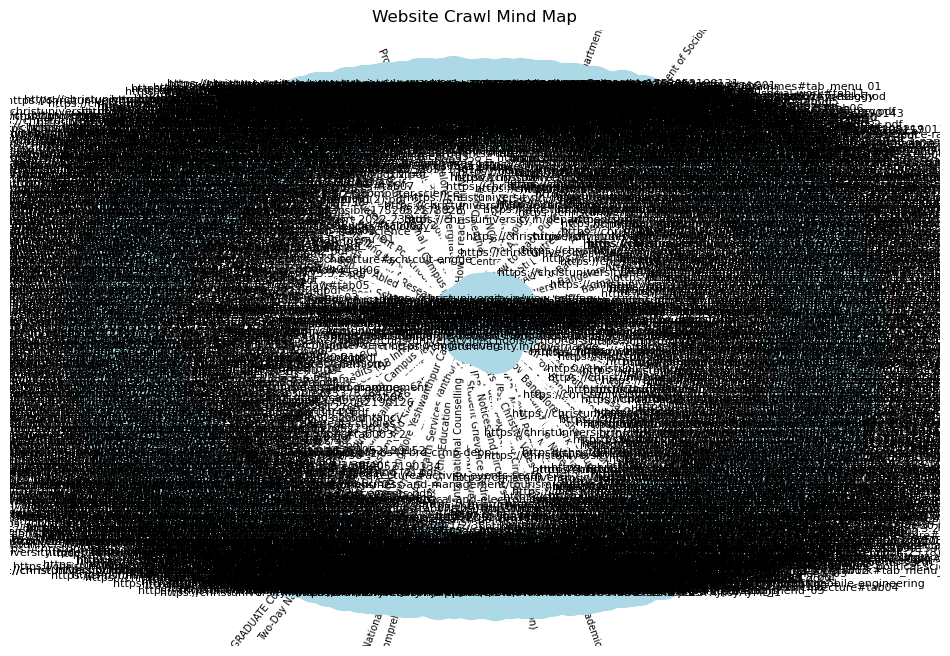

In [10]:
visualize_graph(edges)

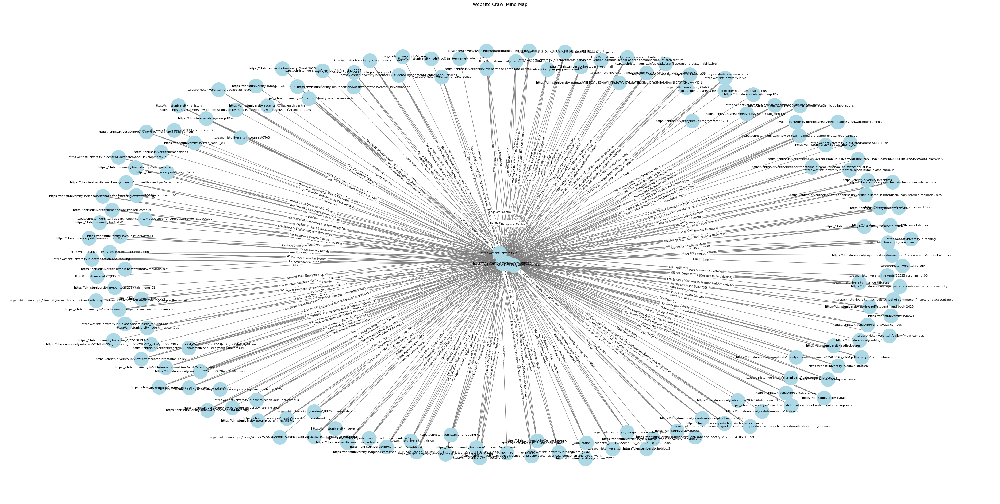

In [16]:
edges = crawl_site(url, max_pages=4)
visualize_graph(edges)

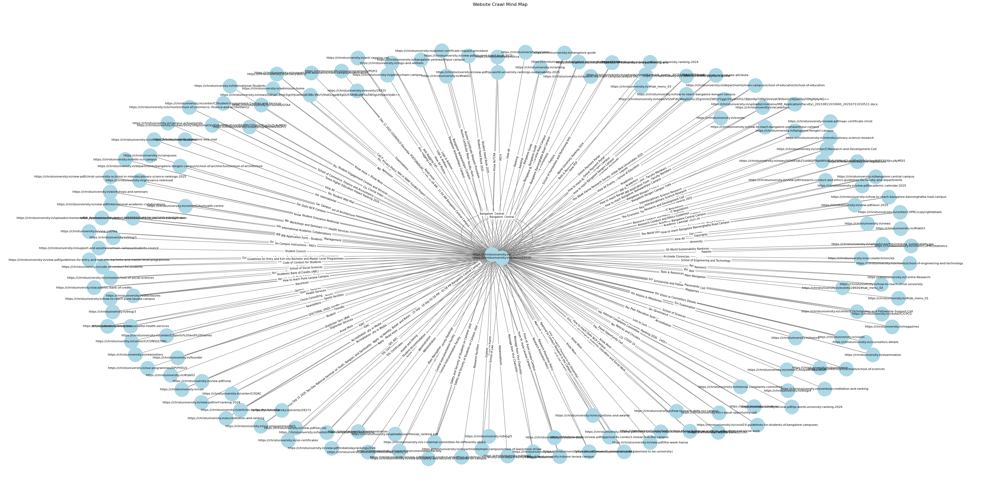

In [15]:
edges = crawl_site(url, max_pages=2)
visualize_graph(edges)

In [17]:
import networkx as nx
import plotly.graph_objects as go
from urllib.parse import urlparse

def visualize_graph_plotly(edges):
    G = nx.DiGraph()

    # Add edges with labels
    for e in edges:
        G.add_edge(e["from"], e["to"], text=e["text"])

    # Layout (same spring force-directed)
    pos = nx.spring_layout(G, k=0.5, iterations=50)

    # Extract node positions
    edge_x = []
    edge_y = []
    edge_texts = []
    for edge in G.edges(data=True):
        x0, y0 = pos[edge[0]]
        x1, y1 = pos[edge[1]]
        edge_x += [x0, x1, None]
        edge_y += [y0, y1, None]
        edge_texts.append(edge[2].get("text", ""))

    # Draw edges
    edge_trace = go.Scatter(
        x=edge_x, y=edge_y,
        line=dict(width=0.5, color="#888"),
        hoverinfo="none",
        mode="lines")

    # Draw nodes
    node_x = []
    node_y = []
    node_labels = []
    for node in G.nodes():
        x, y = pos[node]
        node_x.append(x)
        node_y.append(y)
        # Shorten URL → only path
        parsed = urlparse(node)
        label = parsed.path if parsed.path else parsed.netloc
        node_labels.append(label)

    node_trace = go.Scatter(
        x=node_x, y=node_y,
        mode="markers+text",
        text=node_labels,
        textposition="top center",
        hovertext=list(G.nodes()),
        hoverinfo="text",
        marker=dict(
            showscale=False,
            color="lightblue",
            size=15,
            line=dict(width=2, color="darkblue")
        )
    )

    # Build figure
    fig = go.Figure(data=[edge_trace, node_trace],
        layout=go.Layout(
            title="Website Crawl Mind Map (Interactive)",
            title_x=0.5,
            showlegend=False,
            hovermode="closest",
            margin=dict(b=20, l=5, r=5, t=40),
            xaxis=dict(showgrid=False, zeroline=False, showticklabels=False),
            yaxis=dict(showgrid=False, zeroline=False, showticklabels=False)
        )
    )

    fig.show()


In [19]:
visualize_graph_plotly(edges)

In [3]:
import requests
from bs4 import BeautifulSoup
from urllib.parse import urljoin, urlparse
from collections import deque
import re

def extract_content(url, soup):
    """Extract meaningful content from a page."""
    content = {}

    # Clean visible text (ignoring scripts, styles, navs etc.)
    for script in soup(["script", "style", "noscript", "header", "footer", "nav"]):
        script.extract()
    text = soup.get_text(" ", strip=True)
    text = re.sub(r"\s+", " ", text)  # collapse whitespace
    content["text"] = text if len(text) > 50 else None   # discard very short junk text

    # Collect images
    imgs = []
    for img in soup.find_all("img", src=True):
        img_url = urljoin(url, img["src"])
        imgs.append(img_url)
    content["images"] = imgs if imgs else None

    # Collect tables
    tables = []
    for table in soup.find_all("table"):
        tables.append(str(table))  # raw HTML of table
    content["tables"] = tables if tables else None

    # Collect PDFs & other file links
    pdfs, others = [], []
    for a in soup.find_all("a", href=True):
        href = urljoin(url, a["href"])
        if href.lower().endswith(".pdf"):
            pdfs.append(href)
        elif re.search(r"\.(zip|docx?|xlsx?|pptx?)$", href, re.I):
            others.append(href)
    content["pdfs"] = pdfs if pdfs else None
    content["others"] = others if others else None

    return content


def crawl_site_tree(start_url, max_pages=30):
    domain = urlparse(start_url).netloc
    visited = set()
    tree = {}

    queue = deque([start_url])

    while queue and len(visited) < max_pages:
        url = queue.popleft()
        if url in visited:
            continue
        visited.add(url)

        try:
            resp = requests.get(url, headers={"User-Agent": "LLM-Website-Tree-Crawler/0.1"}, timeout=10)
            if resp.status_code != 200 or "text/html" not in resp.headers.get("Content-Type", ""):
                continue
        except Exception as e:
            print("Failed:", url, e)
            continue

        soup = BeautifulSoup(resp.text, "html.parser")

        # Extract page content
        page_content = extract_content(url, soup)

        # Extract children links
        children = []
        for a in soup.find_all("a", href=True):
            absolute = urljoin(url, a["href"])
            anchor_text = a.get_text(" ", strip=True)

            # Skip out-of-domain links
            if urlparse(absolute).netloc != domain:
                continue
            # Skip junk links (#, empty, no text and no real content)
            if (not anchor_text or anchor_text.isspace()) and not page_content["text"]:
                continue
            if absolute in visited:
                continue

            children.append({
                "url": absolute,
                "anchor_text": anchor_text if anchor_text else None
            })
            queue.append(absolute)

        # Save structure
        tree[url] = {
            "content": page_content,
            "children": children
        }

    return tree


# Example run
site_map = crawl_site_tree(url, max_pages=50)




In [21]:
for i in range(5):
    # Print summary
    for parent, data in site_map.items():
        print(f"\nPage: {parent}")
        print(f"  Text length: {len(data['content']['text'] or '')}")
        print(f"  Images: {len(data['content']['images'] or [])}")
        print(f"  PDFs: {len(data['content']['pdfs'] or [])}")
        print(f"  Children:")
        for c in data["children"]:
            print("   ->", c["url"], "| text:", c["anchor_text"])



Page: https://christuniversity.in/
  Text length: 13014
  Images: 141
  PDFs: 1
  Children:
   -> https://christuniversity.in/courses/OTA4 | text: Know More
   -> https://christuniversity.in/Centre-Research | text: Know More
   -> https://christuniversity.in/courses/OTA3 | text: Know More
   -> https://christuniversity.in/view-pdf/the-week-hansa | text: Know More
   -> https://christuniversity.in/view-pdf/qs-world-university-rankings-sustainability-2025 | text: Know More
   -> https://christuniversity.in/view-pdf/christ-university-is-listed-in-interdisciplinary-science-rankings-2025 | text: Know More
   -> https://christuniversity.in/view-pdf/christ-university-india-is-listed-in-qs-world-university-ranking-2025 | text: Know More
   -> https://christuniversity.in/view-pdf/nirf-ranking-2024 | text: Know More
   -> https://christuniversity.in/view-pdf/indiatodayrankings2024 | text: Know More
   -> https://christuniversity.in/our-programmes/DP(PHD)/1 | text: DOCTORAL (PhD)
   -> https://c

In [6]:
import networkx as nx
import matplotlib.pyplot as plt

def visualize_site_map(tree):
    G = nx.DiGraph()

    # Build edges: parent → child
    for parent, data in tree.items():
        for child in data["children"]:
            G.add_edge(parent, child["url"], label=child.get("anchor_text", ""))

    plt.figure(figsize=(20, 12))
    pos = nx.spring_layout(G, k=0.5, iterations=50)

    # Nodes & Edges
    nx.draw_networkx_nodes(G, pos, node_size=1000, node_color="lightblue")
    nx.draw_networkx_edges(G, pos, arrowstyle="->", arrowsize=15, edge_color="gray")

    # Labels
    nx.draw_networkx_labels(G, pos, font_size=7, font_family="sans-serif")

    # Edge labels (anchor text)
    edge_labels = nx.get_edge_attributes(G, "label")
    nx.draw_networkx_edge_labels(G, pos, edge_labels=edge_labels, font_size=6)

    plt.title("Website Sitemap Tree")
    plt.axis("off")
    plt.show()


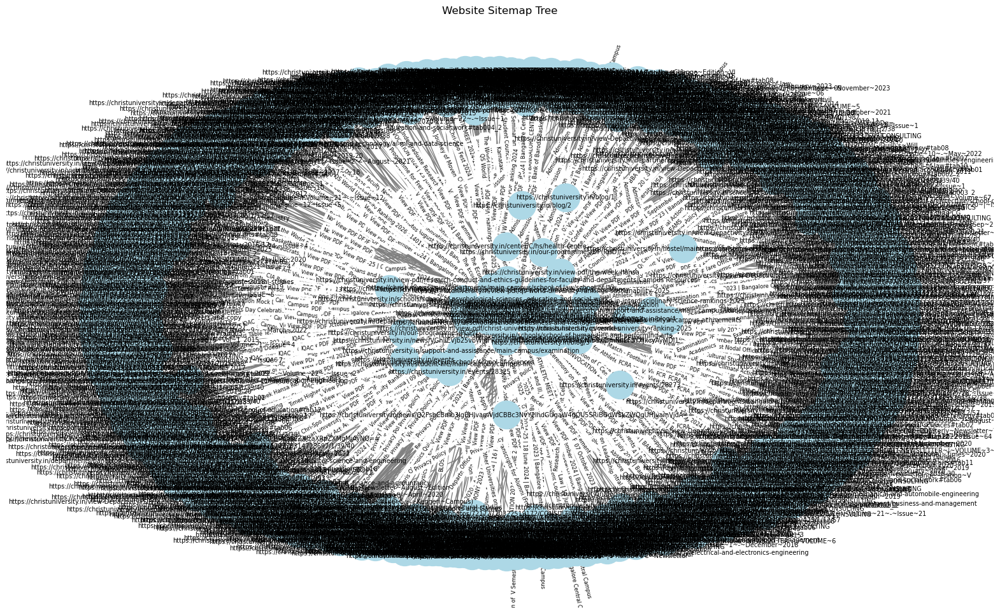

In [26]:
visualize_site_map(site_map)

In [7]:
import plotly.graph_objects as go

def visualize_site_map_plotly(tree):
    G = nx.DiGraph()

    # Build edges
    for parent, data in tree.items():
        for child in data["children"]:
            G.add_edge(parent, child["url"], label=child.get("anchor_text", ""))

    pos = nx.spring_layout(G, k=0.5, iterations=50)

    # Extract coordinates
    x_edges, y_edges = [], []
    for edge in G.edges():
        x_edges += [pos[edge[0]][0], pos[edge[1]][0], None]
        y_edges += [pos[edge[0]][1], pos[edge[1]][1], None]

    edge_trace = go.Scatter(
        x=x_edges, y=y_edges,
        line=dict(width=1, color="gray"),
        hoverinfo="none",
        mode="lines"
    )

    node_x, node_y, text_labels = [], [], []
    for node in G.nodes():
        node_x.append(pos[node][0])
        node_y.append(pos[node][1])
        text_labels.append(node)

    node_trace = go.Scatter(
        x=node_x, y=node_y,
        mode="markers+text",
        text=text_labels,
        textposition="bottom center",
        hovertext=text_labels,
        marker=dict(size=20, color="lightblue", line_width=2),
    )

    fig = go.Figure(data=[edge_trace, node_trace],
                    layout=go.Layout(
                        title="Website Sitemap (Interactive)",
                        showlegend=False,
                        hovermode="closest",
                        margin=dict(b=20, l=5, r=5, t=40),
                        xaxis=dict(showgrid=False, zeroline=False),
                        yaxis=dict(showgrid=False, zeroline=False)
                    ))
    fig.show()


In [8]:
visualize_site_map_plotly(site_map)


In [ ]:
import requests
from bs4 import BeautifulSoup
from urllib.parse import urljoin, urlparse
from collections import deque
import re
import io
from PyPDF2 import PdfReader
import os


def extract_pdf_data(pdf_url):
    """Fetch a PDF and extract title, text, and provide a download link."""
    try:
        resp = requests.get(pdf_url, timeout=10, headers={"User-Agent": "LLM-Website-Tree-Crawler/0.1"})
        if resp.status_code != 200:
            return None

        pdf_file = io.BytesIO(resp.content)
        reader = PdfReader(pdf_file)

        # Title from metadata if available
        title = reader.metadata.title if reader.metadata and reader.metadata.title else None

        # Fallback: filename from URL
        if not title:
            parsed_url = urlparse(pdf_url)
            filename = os.path.basename(parsed_url.path)
            title = filename if filename else "Untitled PDF"

        # Extract text
        text_content = []
        for page in reader.pages:
            try:
                text_content.append(page.extract_text() or "")
            except Exception:
                pass
        text = "\n".join(text_content).strip()

        return {
            "title": title,
            "download_link": pdf_url,
            "content": text if text else None
        }
    except Exception as e:
        print("Failed to parse PDF:", pdf_url, e)
        return None


def extract_content(url, soup):
    """Extract meaningful content from a page."""
    content = {}

    # Clean visible text
    for script in soup(["script", "style", "noscript", "header", "footer", "nav"]):
        script.extract()
    text = soup.get_text(" ", strip=True)
    text = re.sub(r"\s+", " ", text)
    content["text"] = text if len(text) > 50 else None

    # Collect images
    imgs = []
    for img in soup.find_all("img", src=True):
        img_url = urljoin(url, img["src"])
        imgs.append(img_url)
    content["images"] = imgs if imgs else None

    # Collect tables
    tables = []
    for table in soup.find_all("table"):
        tables.append(str(table))
    content["tables"] = tables if tables else None

    # Collect PDFs & other file links
    pdfs, others = [], []
    for a in soup.find_all("a", href=True):
        href = urljoin(url, a["href"])
        if href.lower().endswith(".pdf"):
            pdf_data = extract_pdf_data(href)
            if pdf_data:
                pdfs.append(pdf_data)
        elif re.search(r"\.(zip|docx?|xlsx?|pptx?)$", href, re.I):
            others.append(href)
    content["pdfs"] = pdfs if pdfs else None
    content["others"] = others if others else None

    return content


def crawl_site_tree(start_url, max_pages=30):
    domain = urlparse(start_url).netloc
    visited = set()
    tree = {}

    queue = deque([start_url])

    while queue and len(visited) < max_pages:
        url = queue.popleft()
        if url in visited:
            continue
        visited.add(url)

        try:
            resp = requests.get(url, headers={"User-Agent": "LLM-Website-Tree-Crawler/0.1"}, timeout=10)
            if resp.status_code != 200 or "text/html" not in resp.headers.get("Content-Type", ""):
                continue
        except Exception as e:
            print("Failed:", url, e)
            continue

        soup = BeautifulSoup(resp.text, "html.parser")

        # Extract page content
        page_content = extract_content(url, soup)

        # Extract children links
        children = []
        for a in soup.find_all("a", href=True):
            absolute = urljoin(url, a["href"])
            anchor_text = a.get_text(" ", strip=True)

            if urlparse(absolute).netloc != domain:
                continue
            if (not anchor_text or anchor_text.isspace()) and not page_content["text"]:
                continue
            if absolute in visited:
                continue

            children.append({
                "url": absolute,
                "anchor_text": anchor_text if anchor_text else None
            })
            queue.append(absolute)

        # Save structure
        tree[url] = {
            "content": page_content,
            "children": children
        }

    return tree


# Example
# site_map = crawl_site_tree("https://example.com", max_pages=5)



In [21]:
site_map = crawl_site_tree(url, max_pages=200)

In [15]:
for parent, data in site_map.items():
    i = 1
    if i > 5:
        break
    print(f"\nPage: {parent}")
    print(f"  Text length: {len(data['content']['text'] or '')}")
    print(f"  Images: {len(data['content']['images'] or [])}")
    
    # PDF details
    if data["content"]["pdfs"]:
        print(f"  PDFs Found: {len(data['content']['pdfs'])}")
        for idx, pdf in enumerate(data["content"]["pdfs"], 1):
            print(f"      Title: {pdf.get('title')}")
            if pdf.get("content"):
                print(f"      Text (snippet): {pdf['content'][:200]}...")  # first 200 chars
            else:
                print("      Text: None")
            if pdf.get("download_link"):
                print(f"      Download link: {pdf['download_link']}")
    else:
        print("  PDFs: 0")

    # Children
    print(f"  Children:")
    for c in data["children"]:
        print("   ->", c["url"], "| text:", c["anchor_text"])
    i += 1



Page: https://christuniversity.in/
  Text length: 13014
  Images: 141
  PDFs Found: 1
      Title: qs_ranking.pdf
      Text: None
      Download link: https://christuniversity.in/uploads/userfiles/qs_ranking.pdf
  Children:
   -> https://christuniversity.in/courses/OTA4 | text: Know More
   -> https://christuniversity.in/Centre-Research | text: Know More
   -> https://christuniversity.in/courses/OTA3 | text: Know More
   -> https://christuniversity.in/view-pdf/the-week-hansa | text: Know More
   -> https://christuniversity.in/view-pdf/qs-world-university-rankings-sustainability-2025 | text: Know More
   -> https://christuniversity.in/view-pdf/christ-university-is-listed-in-interdisciplinary-science-rankings-2025 | text: Know More
   -> https://christuniversity.in/view-pdf/christ-university-india-is-listed-in-qs-world-university-ranking-2025 | text: Know More
   -> https://christuniversity.in/view-pdf/nirf-ranking-2024 | text: Know More
   -> https://christuniversity.in/view-pdf/india

In [22]:
import json

def save_site_summary(site_map, filename="site_summary.json"):
    summary = {}

    for parent, data in site_map.items():
        summary[parent] = {
            "text": data['content']['text'] or '',
            "images": data['content']['images'] or [],
            "pdfs": [],
            "children": []
        }

        # PDF details
        if data["content"]["pdfs"]:
            for pdf in data["content"]["pdfs"]:
                pdf_info = {
                    "title": pdf.get("title"),
                    "download_link": pdf.get("download_link") or None,
                    "text_snippet": (pdf.get("content")[:20000] + "...") if pdf.get("content") else None
                }
                summary[parent]["pdfs"].append(pdf_info)

        # Children
        for c in data["children"]:
            summary[parent]["children"].append({
                "url": c["url"],
                "anchor_text": c["anchor_text"]
            })

    # Save to JSON file
    with open(filename, "w", encoding="utf-8") as f:
        json.dump(summary, f, indent=4, ensure_ascii=False)

    print(f"✅ Site summary written to {filename}")
save_site_summary(site_map, filename="site_summary.json")

✅ Site summary written to site_summary.json


In [ ]:
from neo4j import GraphDatabase
import uuid



driver = GraphDatabase.driver(NEO4J_URI, auth=(NEO4J_USER, NEO4J_PASS))

def upsert_page(tx, url, text_len, title=None):
    tx.run("""
    MERGE (p:Page {url:$url})
    SET p.title = coalesce($title, p.title),
        p.text_len = $text_len
    """, url=url, text_len=text_len, title=title)

def upsert_asset(tx, url, type_, filename=None):
    tx.run("""
    MERGE (a:Asset {url:$url})
    SET a.type = $type,
        a.filename = coalesce($filename, a.filename)
    """, url=url, type=type_, filename=filename)

def link_contains(tx, page_url, asset_url):
    tx.run("""
    MATCH (p:Page {url:$purl}), (a:Asset {url:$aurl})
    MERGE (p)-[:CONTAINS]->(a)
    """, purl=page_url, aurl=asset_url)

def link_links_to(tx, from_url, to_url, anchor_text=None):
    tx.run("""
    MATCH (a:Page {url:$from_url}), (b:Page {url:$to_url})
    MERGE (a)-[r:LINKS_TO]->(b)
    SET r.anchor_text = coalesce($anchor, r.anchor_text)
    """, from_url=from_url, to_url=to_url, anchor=anchor_text)

def upsert_chunk(tx, chunk_id, modality, text, page_url=None, asset_url=None):
    tx.run("""
    MERGE (c:Chunk {id:$id})
    SET c.modality=$modality,
        c.text=$text
    WITH c
    OPTIONAL MATCH (p:Page {url:$page_url})
    FOREACH (_ IN CASE WHEN p IS NULL THEN [] ELSE [1] END |
      MERGE (p)-[:HAS_CHUNK]->(c)
    )
    WITH c
    OPTIONAL MATCH (a:Asset {url:$asset_url})
    FOREACH (_ IN CASE WHEN a IS NULL THEN [] ELSE [1] END |
      MERGE (a)-[:HAS_CHUNK]->(c)
    )
    """, id=chunk_id, modality=modality, text=text[:6000], 
         page_url=page_url, asset_url=asset_url)

def ingest_site_map(site_map):
    with driver.session() as sess:
        for parent, data in site_map.items():
            # Page
            title = data.get("title")
            text_len = len(data['content'].get('text') or "")
            sess.execute_write(upsert_page, parent, text_len, title)
            
            # Links (children)
            for child in data.get("children", []):
                child_url = child["url"]
                anchor = child.get("anchor_text")
                sess.execute_write(upsert_page, child_url, 0, None)
                sess.execute_write(link_links_to, parent, child_url, anchor)
            
            # PDFs
            for pdf in data["content"].get("pdfs") or []:
                pdf_url = pdf["download_link"]
                filename = pdf.get("title")
                sess.execute_write(upsert_asset, pdf_url, "pdf", filename)
                sess.execute_write(link_contains, parent, pdf_url)
                
                # PDF chunks
                if pdf.get("content"):
                    chunk_id = str(uuid.uuid5(uuid.NAMESPACE_URL, pdf_url))  # deterministic ID
                    sess.execute_write(upsert_chunk, chunk_id, "text", pdf["content"], None, pdf_url)
            
            # Page text chunks
            text = data["content"].get("text")
            if text:
                chunk_id = str(uuid.uuid5(uuid.NAMESPACE_URL, parent))  # deterministic ID
                sess.execute_write(upsert_chunk, chunk_id, "text", text, parent, None)

In [30]:
ingest_site_map(site_map)

In [ ]:
import weaviate, os

client = weaviate.Client(
    url="http://localhost:8080",  # or your cloud endpoint
)

schema = {
  "classes": [
    {
      "class": "Chunk",
      "properties": [
        {"name": "page_url", "dataType": ["string"]},
        {"name": "asset_url", "dataType": ["string"]},
        {"name": "modality", "dataType": ["string"]},
        {"name": "text", "dataType": ["text"]},
      ],
      "vectorizer": "none",   # we'll push our own embeddings
    }
  ]
}

client.schema.delete_all()
client.schema.create(schema)


In [1]:
import uuid
from typing import List, Dict, Any, Optional, Tuple
from dataclasses import dataclass
from enum import Enum
import numpy as np
from sentence_transformers import SentenceTransformer
import faiss
from neo4j import GraphDatabase
import json
import re
from collections import defaultdict

class SearchMode(Enum):
    SEMANTIC = "semantic"
    GRAPH_WALK = "graph_walk"
    HYBRID = "hybrid"
    MULTIMODAL = "multimodal"

@dataclass
class RetrievedChunk:
    chunk_id: str
    text: str
    modality: str
    score: float
    source_url: str
    source_type: str  # 'page' or 'asset'
    source_title: Optional[str] = None
    context_path: Optional[List[str]] = None  # breadcrumb of how we got here
    related_assets: Optional[List[Dict]] = None

class KnowledgeRetriever:
    def __init__(self, neo4j_driver, embedding_model="all-MiniLM-L6-v2"):
        self.driver = neo4j_driver
        self.embedder = SentenceTransformer(embedding_model)
        self.chunk_embeddings = {}
        self.faiss_index = None
        self.chunk_id_to_index = {}
        self.index_to_chunk_id = {}
        
    def build_vector_index(self):
        """Build FAISS index for semantic search"""
        print("Building vector index...")
        
        # Get all chunks
        with self.driver.session() as session:
            result = session.run("""
                MATCH (c:Chunk)
                RETURN c.id as chunk_id, c.text as text, c.modality as modality
            """)
            chunks = list(result)
            
        if not chunks:
            print("No chunks found!")
            return
            
        # Apply text splitting to match what you did during ingestion
        from langchain.text_splitter import RecursiveCharacterTextSplitter
        text_splitter = RecursiveCharacterTextSplitter(chunk_size=500, chunk_overlap=50)
        
        # Split texts and maintain mapping
        all_split_texts = []
        split_to_chunk_mapping = []  # Maps split index to original chunk
        
        for chunk in chunks:
            if chunk['text'] and chunk['text'].strip():  # Check for valid text
                split_texts = text_splitter.split_text(chunk['text'])
                for split_text in split_texts:
                    if split_text.strip():  # Only add non-empty splits
                        all_split_texts.append(split_text)
                        split_to_chunk_mapping.append(chunk['chunk_id'])
        
        if not all_split_texts:
            print("No valid text found in chunks!")
            return
        
        print(f"Processing {len(all_split_texts)} text splits from {len(chunks)} chunks")
        
        # Generate embeddings for split texts
        embeddings = self.embedder.encode(all_split_texts, show_progress_bar=True)
        
        # Build FAISS index
        dimension = embeddings.shape[1]
        self.faiss_index = faiss.IndexFlatIP(dimension)  # Inner product for cosine similarity
        
        # Normalize embeddings for cosine similarity
        faiss.normalize_L2(embeddings)
        self.faiss_index.add(embeddings.astype(np.float32))
        
        # Create mappings for splits
        self.chunk_id_to_index = {}
        self.index_to_chunk_id = {}
        
        for idx, chunk_id in enumerate(split_to_chunk_mapping):
            self.index_to_chunk_id[idx] = chunk_id
            # Note: chunk_id_to_index may have multiple indices for same chunk_id
            if chunk_id not in self.chunk_id_to_index:
                self.chunk_id_to_index[chunk_id] = []
            self.chunk_id_to_index[chunk_id].append(idx)
            
        print(f"Built index with {len(all_split_texts)} text splits from {len(chunks)} chunks")
        
    def semantic_search(self, query: str, top_k: int = 5) -> List[RetrievedChunk]:
        """Pure semantic search using embeddings"""
        if self.faiss_index is None:
            raise ValueError("Vector index not built. Call build_vector_index() first.")
            
        # Embed query
        query_embedding = self.embedder.encode([query])
        faiss.normalize_L2(query_embedding)
        
        # Search
        scores, indices = self.faiss_index.search(query_embedding.astype(np.float32), top_k)
        
        # Get chunk details from Neo4j
        chunk_ids = [self.index_to_chunk_id[idx] for idx in indices[0]]
        
        with self.driver.session() as session:
            result = session.run("""
                UNWIND $chunk_ids as chunk_id
                MATCH (c:Chunk {id: chunk_id})
                OPTIONAL MATCH (p:Page)-[:HAS_CHUNK]->(c)
                OPTIONAL MATCH (a:Asset)-[:HAS_CHUNK]->(c)
                RETURN c.id as chunk_id, c.text as text, c.modality as modality,
                       p.url as page_url, p.url as page_title,
                       a.url as asset_url, a.filename as asset_filename, a.type as asset_type
            """, chunk_ids=chunk_ids)
            
            chunk_data = {row['chunk_id']: row for row in result}
            
        # Build results
        results = []
        for i, chunk_id in enumerate(chunk_ids):
            if chunk_id in chunk_data:
                data = chunk_data[chunk_id]
                
                source_url = data['page_url'] or data['asset_url']
                source_type = 'page' if data['page_url'] else 'asset'
                source_title = data['page_title'] or data['asset_filename']
                
                results.append(RetrievedChunk(
                    chunk_id=chunk_id,
                    text=data['text'],
                    modality=data['modality'],
                    score=float(scores[0][i]),
                    source_url=source_url,
                    source_type=source_type,
                    source_title=source_title
                ))
                
        return results
    
    def graph_walk_search(self, query: str, start_urls: List[str] = None, max_depth: int = 2) -> List[RetrievedChunk]:
        """Graph-based search following relationships"""
        
        with self.driver.session() as session:
            if start_urls:
                # Start from specific URLs
                cypher = """
                UNWIND $start_urls as url
                MATCH (start:Page {url: url})
                CALL {
                    WITH start
                    MATCH path = (start)-[:LINKS_TO|CONTAINS*1..%d]-(end)
                    WHERE end:Page OR end:Asset
                    RETURN end, length(path) as depth, path
                }
                OPTIONAL MATCH (end)-[:HAS_CHUNK]->(c:Chunk)
                WHERE c.text CONTAINS $query_term OR end.title CONTAINS $query_term
                RETURN DISTINCT c.id as chunk_id, c.text as text, c.modality as modality,
                       end.url as source_url, end.title as source_title,
                       labels(end)[0] as source_type, depth,
                       [node in nodes(path) | node.url] as path_urls
                ORDER BY depth, c.id
                """ % max_depth
            else:
                # Global search
                cypher = """
                MATCH (c:Chunk)
                WHERE c.text CONTAINS $query_term
                OPTIONAL MATCH (p:Page)-[:HAS_CHUNK]->(c)
                OPTIONAL MATCH (a:Asset)-[:HAS_CHUNK]->(c)
                RETURN c.id as chunk_id, c.text as text, c.modality as modality,
                       coalesce(p.url, a.url) as source_url,
                       coalesce(p.url, a.filename) as source_title,
                       CASE WHEN p IS NOT NULL THEN 'Page' ELSE 'Asset' END as source_type,
                       0 as depth, [] as path_urls
                """
                
            # Simple keyword extraction for graph search
            query_terms = re.findall(r'\b\w+\b', query.lower())
            main_term = max(query_terms, key=len) if query_terms else query
            
            result = session.run(cypher, start_urls=start_urls or [], query_term=main_term)
            
            chunks = []
            for row in result:
                chunks.append(RetrievedChunk(
                    chunk_id=row['chunk_id'],
                    text=row['text'],
                    modality=row['modality'],
                    score=1.0 / (row['depth'] + 1),  # Higher score for closer nodes
                    source_url=row['source_url'],
                    source_type=row['source_type'].lower(),
                    source_title=row['source_title'],
                    context_path=row['path_urls']
                ))
                
        return chunks
    
    def multimodal_search(self, query: str, include_assets: bool = True, top_k: int = 10) -> List[RetrievedChunk]:
        """Search across different modalities with context"""
        
        # Start with semantic search
        semantic_results = self.semantic_search(query, top_k)
        
        # Enhance with related assets and context
        enhanced_results = []
        
        with self.driver.session() as session:
            for chunk in semantic_results:
                # Get related assets for page chunks
                if chunk.source_type == 'page' and include_assets:
                    related_assets_result = session.run("""
                        MATCH (p:Page {url: $page_url})-[:CONTAINS]->(a:Asset)
                        RETURN a.url as url, a.type as type, a.filename as filename
                        LIMIT 5
                    """, page_url=chunk.source_url)
                    
                    related_assets = [dict(row) for row in related_assets_result]
                    chunk.related_assets = related_assets if related_assets else None
                
                enhanced_results.append(chunk)
                
        return enhanced_results
    
    def hybrid_search(self, query: str, semantic_weight: float = 0.7, graph_weight: float = 0.3, 
                     top_k: int = 10) -> List[RetrievedChunk]:
        """Combine semantic and graph search"""
        
        # Get results from both methods
        semantic_results = self.semantic_search(query, top_k * 2)
        graph_results = self.graph_walk_search(query)
        
        # Combine and re-rank
        combined_scores = defaultdict(float)
        all_chunks = {}
        
        # Add semantic scores
        for chunk in semantic_results:
            combined_scores[chunk.chunk_id] += chunk.score * semantic_weight
            all_chunks[chunk.chunk_id] = chunk
            
        # Add graph scores
        for chunk in graph_results:
            combined_scores[chunk.chunk_id] += chunk.score * graph_weight
            if chunk.chunk_id not in all_chunks:
                all_chunks[chunk.chunk_id] = chunk
            else:
                # Merge context path if available
                if chunk.context_path and not all_chunks[chunk.chunk_id].context_path:
                    all_chunks[chunk.chunk_id].context_path = chunk.context_path
        
        # Sort by combined score
        sorted_chunks = sorted(
            [(chunk_id, score) for chunk_id, score in combined_scores.items()],
            key=lambda x: x[1], reverse=True
        )[:top_k]
        
        # Update scores and return
        results = []
        for chunk_id, score in sorted_chunks:
            chunk = all_chunks[chunk_id]
            chunk.score = score
            results.append(chunk)
            
        return results
    
    def get_context_window(self, chunk_id: str, window_size: int = 2) -> Dict[str, Any]:
        """Get surrounding context for a chunk"""
        
        with self.driver.session() as session:
            result = session.run("""
                MATCH (c:Chunk {id: $chunk_id})
                OPTIONAL MATCH (source)-[:HAS_CHUNK]->(c)
                WHERE source:Page OR source:Asset
                
                // Get related chunks from same source
                OPTIONAL MATCH (source)-[:HAS_CHUNK]->(related:Chunk)
                WHERE related <> c
                
                // Get connected pages/assets
                OPTIONAL MATCH (source)-[:LINKS_TO|CONTAINS]-(connected)
                WHERE connected:Page OR connected:Asset
                OPTIONAL MATCH (connected)-[:HAS_CHUNK]->(connected_chunk:Chunk)
                
                RETURN c, source,
                       collect(DISTINCT related)[..5] as related_chunks,
                       collect(DISTINCT {node: connected, chunks: collect(DISTINCT connected_chunk)})[..3] as connected_sources
            """, chunk_id=chunk_id)
            
            row = result.single()
            if not row:
                return {}
                
            return {
                'chunk': dict(row['c']),
                'source': dict(row['source']),
                'related_chunks': [dict(c) for c in row['related_chunks']],
                'connected_sources': row['connected_sources']
            }
    
    def search(self, query: str, mode: SearchMode = SearchMode.HYBRID, **kwargs) -> List[RetrievedChunk]:
        """Main search interface"""
        
        if mode == SearchMode.SEMANTIC:
            return self.semantic_search(query, **kwargs)
        elif mode == SearchMode.GRAPH_WALK:
            return self.graph_walk_search(query, **kwargs)
        elif mode == SearchMode.MULTIMODAL:
            return self.multimodal_search(query, **kwargs)
        elif mode == SearchMode.HYBRID:
            return self.hybrid_search(query, **kwargs)
        else:
            raise ValueError(f"Unknown search mode: {mode}")
    
    def format_for_llm(self, chunks: List[RetrievedChunk], include_context: bool = True) -> str:
        """Format retrieved chunks for LLM consumption"""
        
        formatted_parts = []
        
        for i, chunk in enumerate(chunks, 1):
            part = f"## Source {i} (Score: {chunk.score:.3f})\n"
            part += f"**Type:** {chunk.source_type.title()}\n"
            part += f"**URL:** {chunk.source_url}\n"
            
            if chunk.source_title:
                part += f"**Title:** {chunk.source_title}\n"
                
            if chunk.modality != 'text':
                part += f"**Modality:** {chunk.modality}\n"
                
            if chunk.context_path and include_context:
                path_str = " → ".join(chunk.context_path[-3:])  # Last 3 steps
                part += f"**Path:** {path_str}\n"
                
            if chunk.related_assets and include_context:
                assets_str = ", ".join([f"{a['filename']} ({a['type']})" for a in chunk.related_assets[:3]])
                part += f"**Related Assets:** {assets_str}\n"
                
            part += f"\n**Content:**\n{chunk.text}\n\n"
            
            formatted_parts.append(part)
            
        return "\n".join(formatted_parts)

# Example usage
def example_usage():
    # Initialize
    driver = GraphDatabase.driver("bolt://localhost:7687", auth=("neo4j", "password"))
    retriever = KnowledgeRetriever(driver)
    
    # Build vector index (do this once)
    retriever.build_vector_index()
    
    # Different search modes
    query = "machine learning algorithms"
    
    # Semantic search
    semantic_results = retriever.search(query, SearchMode.SEMANTIC, top_k=5)
    
    # Graph walk search
    graph_results = retriever.search(query, SearchMode.GRAPH_WALK, max_depth=2)
    
    # Multimodal search (includes related assets)
    multimodal_results = retriever.search(query, SearchMode.MULTIMODAL, include_assets=True)
    
    # Hybrid search (recommended)
    hybrid_results = retriever.search(query, SearchMode.HYBRID, top_k=10)
    
    # Format for LLM
    llm_context = retriever.format_for_llm(hybrid_results)
    print("=== LLM CONTEXT ===")
    print(llm_context)
    
    # Get detailed context for a specific chunk
    if hybrid_results:
        context = retriever.get_context_window(hybrid_results[0].chunk_id)
        print("\n=== DETAILED CONTEXT ===")
        print(json.dumps(context, indent=2, default=str))



2025-08-25 12:45:45.135235: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:467] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
E0000 00:00:1756125945.352867  121847 cuda_dnn.cc:8579] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
E0000 00:00:1756125945.419996  121847 cuda_blas.cc:1407] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
W0000 00:00:1756125945.932061  121847 computation_placer.cc:177] computation placer already registered. Please check linkage and avoid linking the same target more than once.
W0000 00:00:1756125945.932208  121847 computation_placer.cc:177] computation placer already registered. Please check linkage and avoid linking the same target more than once.
W0000 00:00:1756125945.932215  121847 computation_placer.cc:177] computation placer alr

In [3]:
from neo4j import GraphDatabase

driver = GraphDatabase.driver(NEO4J_URI, auth=(NEO4J_USER, NEO4J_PASS))


In [4]:
with driver.session(database="neo4j") as session:
    result = session.run("RETURN 'Connected to Aura!' AS msg")
    print(result.single()["msg"])

Connected to Aura!


In [5]:
# Verify chunks were created
with driver.session() as session:
    result = session.run("MATCH (c:Chunk) RETURN count(c) as chunk_count")
    count = result.single()["chunk_count"]
    print(f"Total chunks in database: {count}")

Total chunks in database: 241


In [6]:
retriever = KnowledgeRetriever(driver)


In [73]:
# Test the retriever's database connection
with retriever.driver.session() as session:
    result = session.run("MATCH (c:Chunk) RETURN count(c) as chunk_count")
    count = result.single()["chunk_count"] 
    print(f"Retriever sees {count} chunks")
    
    # Also check a sample
    result = session.run("MATCH (c:Chunk) RETURN c.id, c.text LIMIT 3")
    for record in result:
        print(f"Chunk ID: {record['c.id']}")
        print(f"Text preview: {record['c.text'][:100]}...")
        print("---")

Retriever sees 241 chunks
Chunk ID: 2e63a18f-428b-591b-b279-6bbbf186aaeb
Text preview: CHRIST (Deemed to be University), Bengaluru - 560029 Your browser does not support HTML5 video. PG D...
---
Chunk ID: f1e9b266-8b48-5869-8d93-adeddb20e600
Text preview: CHRIST UNIVERSITY Bangalore Central Campus Open from: 22-Aug-2025 Open until: 28-Aug-2025 Apply Back...
---
Chunk ID: 8c07374c-0d39-5eb4-ab33-812d2d2cba54
Text preview: CHRIST UNIVERSITY Sidebar Centre for Research The Centre for Research at CHRIST (Deemed to be Univer...
---


In [7]:
    
    # Build vector index (do this once)
retriever.build_vector_index()

Building vector index...
Processing 1277 text splits from 241 chunks


Batches:   0%|          | 0/40 [00:00<?, ?it/s]

Built index with 1277 text splits from 241 chunks


In [8]:
with driver.session() as session:
    # Check Page properties
    result = session.run("MATCH (p:Page) RETURN keys(p) as props LIMIT 1")
    page_props = result.single()
    print(f"Page properties: {page_props['props'] if page_props else 'No pages found'}")
    
    # Check Chunk properties  
    result = session.run("MATCH (c:Chunk) RETURN keys(c) as props LIMIT 1")
    chunk_props = result.single()
    print(f"Chunk properties: {chunk_props['props'] if chunk_props else 'No chunks found'}")
    
    # Check Asset properties
    result = session.run("MATCH (a:Asset) RETURN keys(a) as props LIMIT 1")  
    asset_props = result.single()
    print(f"Asset properties: {asset_props['props'] if asset_props else 'No assets found'}")

Page properties: ['url', 'text_len']
Chunk properties: ['id', 'modality', 'text']
Asset properties: ['url', 'type', 'filename']


In [17]:
    # Different search modes
query = "what post graduation programs offered in computer science"

    # Semantic search
semantic_results = retriever.search(query, SearchMode.SEMANTIC, top_k=5)
print(f"Semantic search found {len(semantic_results)} results")
print(f"Semantic search results: {semantic_results}")


Semantic search found 5 results
Semantic search results: [RetrievedChunk(chunk_id='e0f18a60-5fc2-57da-bbef-998d2831b3e7', text="CHRIST UNIVERSITY School of Engineering and Technology Programmes in School of Engineering and Technology AI, ML and Data Science Civil Engineering Computer Science and Engineering Electrical and Electronics Engineering Electronics and Communication Engineering Mechanical and Automobile Engineering Sciences and Humanities (Engineering) AI, ML and Data Science Civil Engineering Computer Science and Engineering Electrical and Electronics Engineering Electronics and Communication Engineering Mechanical and Automobile Engineering Sciences and Humanities (Engineering) Message from Dean DR. RAGHUNANDAN KUMAR BE, ME, MBA, PhD Email: dean.engineering@christuniversity.in Welcome to the School of Engineering and Technology(SoET) at CHRIST (Deemed to be University). Established in 2009, SoET is a unique and fastest-growing school that equips students and scholars with th

In [14]:
semantic_results

[RetrievedChunk(chunk_id='f130d95a-ac73-5c35-9665-7785f886c90c', text="CHRIST UNIVERSITY SELECT * FROM content WHERE content_category='Activities' AND content_status='1' AND content_menulevel = '1' AND content_menu_masterid ='4353' ORDER BY content_title DESC Activities Consolidated Events Back to Department Sidebar Reports 2020 City & Frames - 2021 Activity Report on Motion Picture Workshop LANDSCAPE AND ECOLOGY WORKSHOP B E N G A L U R U CONDUCTED BY AR.VAGISH NAGANUR Report on Health and Built Environment ANSH SELECTION PROCESS 2021-22 FACULTY DEVELOPMENT PROGRAM - I 2021-22 SESSION IV - LEARNING FROM THE PANDEMIC PHENOMENOLOGY - LECTURE Studio on Wheels for Skills Development - Channapatna Crafts Park - 2021 Report On Webinar on Design Patent Filing Procedures F. D. P. SoA Accreditation Conclave Report of Webinar on Copy Right Procedures Strategic Plan Conclave - 2021 Hands-on Workshop for Skills Development - The Blue Tarpaulin - 2021 Masterclass on STAAD Pro History & Theory of A

In [18]:
    
    # Graph walk search
graph_results = retriever.search(query, SearchMode.GRAPH_WALK, max_depth=2)
print(f"Graph walk found {len(graph_results)} results")
print(f"Graph walk results: {graph_results}")


Graph walk found 1 results
Graph walk results: [RetrievedChunk(chunk_id='7f0dc339-62f3-59b8-81c3-4790515b0a7a', text='CHRIST UNIVERSITY Hotel Management Departments in School of Business and Management Back to School Page Sidebar UNDERGRADUATE Comprehensive undergraduate programmes building strong academic and professional foundations. UNDERGRADUATE Comprehensive undergraduate programmes building strong academic and professional foundations. About The professional BHM course at CHRIST (Deemed to be University) aims at developing young talent for the hotel industry and build in the other strengths such that they are able to venture into allied fields too. The training program focuses on imbibing technical knowledge and skills in hotel operations. The aim of this course is to provide “a cut above the rest” man-power to the ever-growing demands of the hotel and tourism industry. The interactive method of teaching at CHRIST (Deemed to be University) is to bring about attitudinal changes to

In [19]:
    # Multimodal search (includes related assets)
multimodal_results = retriever.search(query, SearchMode.MULTIMODAL, include_assets=True)
print(f"Multimodal search found {len(multimodal_results)} results")
print(f"Multimodal search results: {multimodal_results}")


Multimodal search found 10 results
Multimodal search results: [RetrievedChunk(chunk_id='e0f18a60-5fc2-57da-bbef-998d2831b3e7', text="CHRIST UNIVERSITY School of Engineering and Technology Programmes in School of Engineering and Technology AI, ML and Data Science Civil Engineering Computer Science and Engineering Electrical and Electronics Engineering Electronics and Communication Engineering Mechanical and Automobile Engineering Sciences and Humanities (Engineering) AI, ML and Data Science Civil Engineering Computer Science and Engineering Electrical and Electronics Engineering Electronics and Communication Engineering Mechanical and Automobile Engineering Sciences and Humanities (Engineering) Message from Dean DR. RAGHUNANDAN KUMAR BE, ME, MBA, PhD Email: dean.engineering@christuniversity.in Welcome to the School of Engineering and Technology(SoET) at CHRIST (Deemed to be University). Established in 2009, SoET is a unique and fastest-growing school that equips students and scholars wi

In [20]:
    
    # Hybrid search (recommended)
hybrid_results = retriever.search(query, SearchMode.HYBRID, top_k=10)
print(f"Hybrid search found {len(hybrid_results)} results")
print(f"Hybrid search results: {hybrid_results}")
hybrid_results


Hybrid search found 10 results
Hybrid search results: [RetrievedChunk(chunk_id='77415e8c-d5ba-53f9-a2c1-0fd444668339', text='CHRIST UNIVERSITY School of Sciences Programmes in School of Sciences Chemistry Computer Science Life Sciences Mathematics Physics and Electronics Statistics and Data Science Chemistry Computer Science Life Sciences Mathematics Physics and Electronics Statistics and Data Science Message from Dean Dr Joseph T V MSc, MPhil, PhD Email: dean.sciences@christuniversity.in Dear Christies, School of Sciences at CHRIST University has created a niche in the realm of higher education in India through its programmes. It offers undergraduate, postgraduate, doctoral, and post-doctoral programmes in the disciplines of Chemistry, Physics & Electronics, Mathematics, Life Sciences, and Computer Science & Statistics. Read More × Message from Dean Dear Christies, School of Sciences at CHRIST University has created a niche in the realm of higher education in India through its program

[RetrievedChunk(chunk_id='77415e8c-d5ba-53f9-a2c1-0fd444668339', text='CHRIST UNIVERSITY School of Sciences Programmes in School of Sciences Chemistry Computer Science Life Sciences Mathematics Physics and Electronics Statistics and Data Science Chemistry Computer Science Life Sciences Mathematics Physics and Electronics Statistics and Data Science Message from Dean Dr Joseph T V MSc, MPhil, PhD Email: dean.sciences@christuniversity.in Dear Christies, School of Sciences at CHRIST University has created a niche in the realm of higher education in India through its programmes. It offers undergraduate, postgraduate, doctoral, and post-doctoral programmes in the disciplines of Chemistry, Physics & Electronics, Mathematics, Life Sciences, and Computer Science & Statistics. Read More × Message from Dean Dear Christies, School of Sciences at CHRIST University has created a niche in the realm of higher education in India through its programmes. It offers undergraduate, postgraduate, doctoral, 

In [ ]:
import os
import pickle
import json
import faiss
import numpy as np
from pathlib import Path
from typing import Dict, List, Any, Optional
import sqlite3
from dataclasses import asdict

class OfflineKnowledgeRetriever:
    """Offline version of KnowledgeRetriever that doesn't need Neo4j"""
    
    def __init__(self, index_path: str = None):
        self.embedder = None
        self.faiss_index = None
        self.chunk_metadata = {}  # Store chunk data locally
        self.index_to_chunk_id = {}
        self.chunk_id_to_index = {}
        self.index_path = index_path or "retriever_offline"
        
    def load_from_online_retriever(self, online_retriever):
        """Load data from an online retriever instance"""
        self.embedder = online_retriever.embedder
        self.faiss_index = online_retriever.faiss_index
        self.index_to_chunk_id = online_retriever.index_to_chunk_id.copy()
        self.chunk_id_to_index = online_retriever.chunk_id_to_index.copy()
        
        # Export chunk metadata from Neo4j
        print("Exporting chunk metadata from Neo4j...")
        with online_retriever.driver.session() as session:
            result = session.run("""
                MATCH (c:Chunk)
                OPTIONAL MATCH (p:Page)-[:HAS_CHUNK]->(c)
                OPTIONAL MATCH (a:Asset)-[:HAS_CHUNK]->(c)
                RETURN c.id as chunk_id, c.text as text, c.modality as modality,
                       p.url as page_url, a.url as asset_url, a.filename as asset_filename, 
                       a.type as asset_type
            """)
            
            for row in result:
                chunk_id = row['chunk_id']
                self.chunk_metadata[chunk_id] = {
                    'text': row['text'],
                    'modality': row['modality'],
                    'page_url': row['page_url'],
                    'asset_url': row['asset_url'],
                    'asset_filename': row['asset_filename'],
                    'asset_type': row['asset_type']
                }
        
        print(f"Loaded metadata for {len(self.chunk_metadata)} chunks")
        
    def save_offline(self, base_path: str = None):
        """Save all retriever data for offline use"""
        if base_path:
            self.index_path = base_path
            
        # Create directory
        Path(self.index_path).mkdir(parents=True, exist_ok=True)
        
        print(f"Saving retriever to {self.index_path}...")
        
        # 1. Save FAISS index
        if self.faiss_index:
            faiss.write_index(self.faiss_index, f"{self.index_path}/faiss_index.bin")
            print("✓ FAISS index saved")
        
        # 2. Save mappings
        with open(f"{self.index_path}/mappings.json", 'w') as f:
            json.dump({
                'index_to_chunk_id': self.index_to_chunk_id,
                'chunk_id_to_index': self.chunk_id_to_index
            }, f, indent=2)
        print("✓ Index mappings saved")
        
        # 3. Save chunk metadata to SQLite for efficient querying
        conn = sqlite3.connect(f"{self.index_path}/chunks.db")
        cursor = conn.cursor()
        
        # Create table
        cursor.execute("""
            CREATE TABLE IF NOT EXISTS chunks (
                chunk_id TEXT PRIMARY KEY,
                text TEXT,
                modality TEXT,
                page_url TEXT,
                asset_url TEXT,
                asset_filename TEXT,
                asset_type TEXT,
                source_url TEXT,
                source_type TEXT,
                source_title TEXT
            )
        """)
        
        # Insert data
        for chunk_id, data in self.chunk_metadata.items():
            source_url = data['page_url'] or data['asset_url']
            source_type = 'page' if data['page_url'] else 'asset'
            source_title = data['page_url'] or data['asset_filename']
            
            cursor.execute("""
                INSERT OR REPLACE INTO chunks 
                (chunk_id, text, modality, page_url, asset_url, asset_filename, 
                 asset_type, source_url, source_type, source_title)
                VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
            """, (
                chunk_id, data['text'], data['modality'], data['page_url'],
                data['asset_url'], data['asset_filename'], data['asset_type'],
                source_url, source_type, source_title
            ))
        
        conn.commit()
        conn.close()
        print("✓ Chunk metadata saved to SQLite")
        
        # 4. Save embedder info
        with open(f"{self.index_path}/config.json", 'w') as f:
            json.dump({
                'model_name': self.embedder.get_sentence_embedding_dimension() if hasattr(self.embedder, 'get_sentence_embedding_dimension') else 'unknown',
                'total_chunks': len(self.chunk_metadata),
                'index_size': len(self.index_to_chunk_id)
            }, f, indent=2)
        print("✓ Configuration saved")
        
        print(f"✅ Offline retriever saved successfully to {self.index_path}")
        return self.index_path
        
    def load_offline(self, index_path: str = None):
        """Load retriever from offline files"""
        if index_path:
            self.index_path = index_path
            
        if not Path(self.index_path).exists():
            raise FileNotFoundError(f"Offline index not found at {self.index_path}")
            
        print(f"Loading offline retriever from {self.index_path}...")
        
        # 1. Load embedder (you'll need to specify the model)
        from sentence_transformers import SentenceTransformer
        self.embedder = SentenceTransformer("all-MiniLM-L6-v2")  # Default model
        print("✓ Embedder loaded")
        
        # 2. Load FAISS index
        faiss_path = f"{self.index_path}/faiss_index.bin"
        if os.path.exists(faiss_path):
            self.faiss_index = faiss.read_index(faiss_path)
            print("✓ FAISS index loaded")
        
        # 3. Load mappings
        with open(f"{self.index_path}/mappings.json", 'r') as f:
            mappings = json.load(f)
            # Convert string keys back to integers for index_to_chunk_id
            self.index_to_chunk_id = {int(k): v for k, v in mappings['index_to_chunk_id'].items()}
            self.chunk_id_to_index = mappings['chunk_id_to_index']
        print("✓ Mappings loaded")
        
        # 4. Load config
        with open(f"{self.index_path}/config.json", 'r') as f:
            config = json.load(f)
        print(f"✓ Configuration loaded: {config['total_chunks']} chunks")
        
        print("✅ Offline retriever loaded successfully")
        return True
        
    def search(self, query: str, top_k: int = 5) -> List[Dict[str, Any]]:
        """Search using offline index"""
        if not self.faiss_index or not self.embedder:
            raise ValueError("Retriever not properly loaded. Call load_offline() first.")
            
        # Embed query
        query_embedding = self.embedder.encode([query])
        faiss.normalize_L2(query_embedding)
        
        # Search FAISS index
        scores, indices = self.faiss_index.search(query_embedding.astype(np.float32), top_k)
        
        # Get chunk details from SQLite
        conn = sqlite3.connect(f"{self.index_path}/chunks.db")
        cursor = conn.cursor()
        
        results = []
        for i, idx in enumerate(indices[0]):
            if idx in self.index_to_chunk_id:
                chunk_id = self.index_to_chunk_id[idx]
                
                cursor.execute("""
                    SELECT * FROM chunks WHERE chunk_id = ?
                """, (chunk_id,))
                
                row = cursor.fetchone()
                if row:
                    results.append({
                        'chunk_id': row[0],
                        'text': row[1],
                        'modality': row[2],
                        'source_url': row[7],
                        'source_type': row[8],
                        'source_title': row[9],
                        'score': float(scores[0][i])
                    })
        
        conn.close()
        return results
    
    def get_stats(self) -> Dict[str, Any]:
        """Get statistics about the offline index"""
        conn = sqlite3.connect(f"{self.index_path}/chunks.db")
        cursor = conn.cursor()
        
        cursor.execute("SELECT COUNT(*) FROM chunks")
        total_chunks = cursor.fetchone()[0]
        
        cursor.execute("SELECT COUNT(DISTINCT source_url) FROM chunks")
        unique_sources = cursor.fetchone()[0]
        
        cursor.execute("SELECT source_type, COUNT(*) FROM chunks GROUP BY source_type")
        type_counts = dict(cursor.fetchall())
        
        conn.close()
        
        return {
            'total_chunks': total_chunks,
            'unique_sources': unique_sources,
            'type_distribution': type_counts,
            'index_size': self.faiss_index.ntotal if self.faiss_index else 0,
            'index_path': self.index_path
        }

# Helper functions for easy export/import
def export_retriever_offline(online_retriever, save_path: str = "retriever_offline"):
    """Export an online retriever to offline format"""
    offline_retriever = OfflineKnowledgeRetriever()
    offline_retriever.load_from_online_retriever(online_retriever)
    return offline_retriever.save_offline(save_path)

def load_retriever_offline(index_path: str = "retriever_offline"):
    """Load an offline retriever"""
    offline_retriever = OfflineKnowledgeRetriever()
    offline_retriever.load_offline(index_path)
    return offline_retriever

# Usage example
def example_usage():
    """Example of how to save and load offline retriever"""
    
    # Assume you have your online retriever working
    # from neo4j import GraphDatabase
    # from knowledge_retriever import KnowledgeRetriever
    
    # # 1. Export from online to offline
    # driver = GraphDatabase.driver("neo4j+s://your-uri", auth=("neo4j", "password"))
    # online_retriever = KnowledgeRetriever(driver)
    # online_retriever.build_vector_index()
    
    # Save offline
    offline_path = export_retriever_offline(online_retriever, "my_retriever_offline")
    print(f"Saved to: {offline_path}")
    
    # 2. Load and use offline (no Neo4j needed)
    offline_retriever = load_retriever_offline("my_retriever_offline")
    
    # Search offline
    results = offline_retriever.search("master programs", top_k=5)
    
    for i, result in enumerate(results, 1):
        print(f"{i}. Score: {result['score']:.3f}")
        print(f"   Source: {result['source_url']}")
        print(f"   Text: {result['text'][:100]}...")
        print()
    
    # Get stats
    stats = offline_retriever.get_stats()
    print("Index Statistics:")
    print(json.dumps(stats, indent=2))



In [23]:
offline_path = export_retriever_offline(retriever, "my_retriever_offline")
print(f"Saved to: {offline_path}")
    
    # 2. Load and use offline (no Neo4j needed)

Exporting chunk metadata from Neo4j...
Loaded metadata for 241 chunks
Saving retriever to my_retriever_offline...
✓ FAISS index saved
✓ Index mappings saved
✓ Chunk metadata saved to SQLite
✓ Configuration saved
✅ Offline retriever saved successfully to my_retriever_offline
Saved to: my_retriever_offline


In [24]:
offline_retriever = load_retriever_offline("my_retriever_offline")
results = offline_retriever.search("events upcomming", top_k=5)

Loading offline retriever from my_retriever_offline...
✓ Embedder loaded
✓ FAISS index loaded
✓ Mappings loaded
✓ Configuration loaded: 241 chunks
✅ Offline retriever loaded successfully


In [25]:
print(f"Offline search found {len(results)} results")
print(f"Offline search results: {results}")

Offline search found 5 results
Offline search results: [{'chunk_id': '3d376d28-f2b9-5a50-b537-3f872998f0e2', 'text': "CHRIST UNIVERSITY School of Psychological Sciences, Education and Social Work Programmes in School of Psychological Sciences, Education and Social Work Psychology School of Education Social Work Psychology School of Education Social Work Message from Dean Dr Surekha Chukkali MA, PhD Email: dean.psychologicalsciences@christuniversity.in I am extremely pleased to extend a warm welcome to the School of Psychological Sciences, CHRIST (Deemed to be University) Bangalore Central Campus on behalf of all faculty, students and staff. The School of Psychological Sciences at CHRIST (Deemed to be University) Bangalore Central campus benefits from a rich tradition of academic lineage where Read More × Message from Dean I am extremely pleased to extend a warm welcome to the School of Psychological Sciences, CHRIST (Deemed to be University) Bangalore Central Campus on behalf of all fa

In [27]:
results = retriever.search("events upcomming", top_k=5)
print(f"Offline search found {len(results)} results")
print(f"Offline search results: {results}")

Offline search found 5 results
Offline search results: [RetrievedChunk(chunk_id='6969453f-7ffd-5b84-8cdf-26d061afcfd2', text='CHRIST UNIVERSITY Sports and Games Sidebar × Overview Physical education provides cognitive content and instruction designed to develop motor skills, knowledge, and behaviors for physical activity and physical fitness. Supporting schools to establish physical education daily can provide students with the ability and confidence to be physically active for a lifetime. UPCOMING EVENTS CHRISPO FEST 2022-23 Vision To enhance the quality of every student and faculty through physical mental, social, emotional and career development. Mission To enhance and create awareness on various activities and facilities offered by the Department of Physical Education. To indentify talent at the entry level and create an opportunity to take part in state, national and inter-university competitions. To identify the coaches and provide systematic coaching to the students to build the

In [99]:
import json
import re
from typing import Dict, List, Any, Optional, Tuple
from dataclasses import dataclass, asdict
from enum import Enum
from langchain_groq import ChatGroq
from langchain.schema import HumanMessage, SystemMessage, AIMessage
from langchain.memory import ConversationBufferMemory
import networkx as nx
from collections import defaultdict, deque
import requests
from bs4 import BeautifulSoup
from urllib.parse import urljoin, urlparse
import time
# Web Owl personality configuration
WEB_OWL_PERSONALITY = {
    "humor_level": 0.1,
    "professionalism": 0.7,
    "helpfulness": 0.8,
    "curiosity": 0.7
}

class AgentRole(Enum):
    INFORMATION_STRUCTURER = "information_structurer"
    SITE_MAPPER = "site_mapper" 
    RESPONSE_STRUCTURER = "response_structurer"
    FINAL_VERIFIER = "final_verifier"

@dataclass
class WebOwlResponse:
    query: str
    final_answer: str
    structured_info: Dict[str, Any]
    site_navigation: Dict[str, Any]
    confidence_score: float
    sources_used: List[str]
    navigation_path: List[str]
    humor_quote: Optional[str] = None
class SearchMode(Enum):
    SEMANTIC = "semantic"
    GRAPH_WALK = "graph_walk"
    HYBRID = "hybrid"
    MULTIMODAL = "multimodal"
class SiteMapper:
    """Enhanced site mapper that understands website structure and relationships"""
    
    def __init__(self, retriever):
        self.retriever = retriever
        self.site_graph = nx.DiGraph()
        self._build_site_graph()
        
    def _build_site_graph(self):
        """Build a comprehensive site graph from Neo4j data"""
        print("🦉 Building site navigation map...")
        
        with self.retriever.driver.session() as session:
            # Get all pages and their relationships
            result = session.run("""
                MATCH (p:Page)
                OPTIONAL MATCH (p)-[r:LINKS_TO]->(target:Page)
                OPTIONAL MATCH (p)-[:CONTAINS]->(a:Asset)
                RETURN p.url as page_url, p.text_len as content_length,
                       collect(DISTINCT {url: target.url, anchor: r.anchor_text}) as links,
                       collect(DISTINCT {url: a.url, type: a.type, filename: a.filename}) as assets
            """)
            
            for row in result:
                page_url = row['page_url']
                
                # Add page node with metadata
                self.site_graph.add_node(page_url, 
                                       node_type='page',
                                       content_length=row['content_length'],
                                       assets=row['assets'])
                
                # Add links as edges
                for link in row['links']:
                    if link['url']:
                        self.site_graph.add_edge(page_url, link['url'], 
                                               anchor_text=link['anchor'],
                                               edge_type='navigation')
                
                # Add assets as nodes and connections
                for asset in row['assets']:
                    if asset['url']:
                        asset_url = asset['url']
                        self.site_graph.add_node(asset_url,
                                               node_type='asset',
                                               asset_type=asset['type'],
                                               filename=asset['filename'])
                        self.site_graph.add_edge(page_url, asset_url,
                                               edge_type='contains')
        
        print(f"🗺️ Site map built: {self.site_graph.number_of_nodes()} pages/assets, {self.site_graph.number_of_edges()} connections")
    
    def find_navigation_path(self, start_url: str, target_content: str) -> List[str]:
        """Find the best navigation path to reach specific content"""
        
        # Find pages that might contain the target content
        relevant_pages = []
        with self.retriever.driver.session() as session:
            result = session.run("""
                MATCH (c:Chunk)
                WHERE c.text CONTAINS $content
                OPTIONAL MATCH (p:Page)-[:HAS_CHUNK]->(c)
                RETURN DISTINCT p.url as page_url
                LIMIT 5
            """, content=target_content.lower())
            
            relevant_pages = [row['page_url'] for row in result if row['page_url']]
        
        if not relevant_pages:
            return []
            
        # Find shortest path to most relevant page
        paths = []
        for target_page in relevant_pages:
            if start_url in self.site_graph and target_page in self.site_graph:
                try:
                    path = nx.shortest_path(self.site_graph, start_url, target_page)
                    paths.append(path)
                except nx.NetworkXNoPath:
                    continue
        
        return min(paths, key=len) if paths else []
    
    def get_page_context(self, url: str) -> Dict[str, Any]:
        """Get comprehensive context about a page"""
        if url not in self.site_graph:
            return {}
            
        node_data = self.site_graph.nodes[url]
        
        # Get incoming and outgoing links
        incoming = list(self.site_graph.predecessors(url))
        outgoing = list(self.site_graph.successors(url))
        
        # Get related assets
        assets = [n for n in outgoing if self.site_graph.nodes[n].get('node_type') == 'asset']
        
        return {
            'url': url,
            'content_length': node_data.get('content_length', 0),
            'incoming_links': len(incoming),
            'outgoing_links': len([n for n in outgoing if self.site_graph.nodes[n].get('node_type') == 'page']),
            'assets': assets,
            'parent_pages': incoming,
            'child_pages': [n for n in outgoing if self.site_graph.nodes[n].get('node_type') == 'page']
        }
    
    def generate_sitemap_summary(self) -> Dict[str, Any]:
        """Generate a summary of the site structure"""
        pages = [n for n in self.site_graph.nodes() if self.site_graph.nodes[n].get('node_type') == 'page']
        assets = [n for n in self.site_graph.nodes() if self.site_graph.nodes[n].get('node_type') == 'asset']
        
        # Find root pages (pages with no incoming links from other pages)
        root_pages = [n for n in pages if not any(
            self.site_graph.nodes[pred].get('node_type') == 'page' 
            for pred in self.site_graph.predecessors(n)
        )]
        
        # Calculate depth of each page
        page_depths = {}
        for root in root_pages:
            distances = nx.single_source_shortest_path_length(self.site_graph, root)
            for page, depth in distances.items():
                if self.site_graph.nodes[page].get('node_type') == 'page':
                    page_depths[page] = min(page_depths.get(page, float('inf')), depth)
        
        return {
            'total_pages': len(pages),
            'total_assets': len(assets),
            'root_pages': root_pages,
            'max_depth': max(page_depths.values()) if page_depths else 0,
            'avg_links_per_page': sum(len(list(self.site_graph.successors(p))) for p in pages) / len(pages) if pages else 0
        }

class WebOwlAgent:
    """Base class for Web Owl agents with personality"""
    
    def __init__(self, role: AgentRole, llm_client, personality: Dict[str, float] = None):
        self.role = role
        self.llm = llm_client
        self.personality = personality or WEB_OWL_PERSONALITY
        self.memory = ConversationBufferMemory()
        
    def _add_personality_to_prompt(self, base_prompt: str) -> str:
        """Add Web Owl personality traits to prompts"""
        personality_traits = f"""
You are Web Owl 🦉, an intelligent web navigation assistant with these traits:
- {int(self.personality['humor_level'] * 100)}% humor (add light wit and owl puns where appropriate)
- {int(self.personality['professionalism'] * 100)}% professionalism (maintain expertise and accuracy)
- {int(self.personality['helpfulness'] * 100)}% helpfulness (go above and beyond for users)
- {int(self.personality['curiosity'] * 100)}% curiosity (explore connections and provide insights)

Your role: {self.role.value.replace('_', ' ').title()}

{base_prompt}

Remember to be helpful while maintaining a balance of professionalism and light humor. Think like a wise owl who knows the web inside and out! 🦉
"""
        return personality_traits
    
    def generate_humor_quote(self) -> str:
        """Generate a light humor quote for responses"""
        quotes = [
            "Hoot hoot! Knowledge is power, but navigation is key! 🦉",
            "As wise owls say: 'The best information is just a click away!' 🔍",
            "Flying through the web faster than a night owl! 🌙",
            "Who needs Google when you have owl-some navigation skills? 😄",
            "Perching on the perfect answer, one search at a time! 🎯"
        ]
        import random
        return random.choice(quotes) if self.personality['humor_level'] > 0.15 else None

class InformationStructurerAgent(WebOwlAgent):
    """Structures and organizes retrieved information"""
    
    def __init__(self, llm_client, retriever):
        super().__init__(AgentRole.INFORMATION_STRUCTURER, llm_client)
        self.retriever = retriever
        
    def structure_information(self, query: str, retrieved_chunks: List) -> Dict[str, Any]:
        """Structure retrieved information by relevance, source, and content type"""
        
        prompt = self._add_personality_to_prompt(f"""
Analyze and structure the following retrieved information for the query: "{query}"

Retrieved Information:
{self._format_chunks_for_analysis(retrieved_chunks)}

Your task:
1. Categorize information by topic/theme
2. Identify key facts, procedures, and concepts
3. Note information gaps or inconsistencies
4. Rank information by relevance to the query
5. Identify the most authoritative sources

Provide a structured JSON response with:
- categorized_info: Dict with themes as keys
- key_facts: List of most important facts
- information_gaps: List of missing information
- source_authority: Ranking of sources by reliability
- relevance_scores: Scores for each piece of information
""")
        
        messages = [SystemMessage(content=prompt)]
        
        response = self.llm.invoke(messages)
        try:
            # Extract JSON from response
            json_match = re.search(r'\{.*\}', response.content, re.DOTALL)
            if json_match:
                return json.loads(json_match.group())
        except:
            pass
            
        # Fallback manual structuring
        return self._manual_structure(query, retrieved_chunks)
    
    def _format_chunks_for_analysis(self, chunks: List) -> str:
        """Format chunks for LLM analysis"""
        formatted = []
        for i, chunk in enumerate(chunks, 1):
            formatted.append(f"""
Source {i}:
URL: {getattr(chunk, 'source_url', 'Unknown')}
Type: {getattr(chunk, 'source_type', 'Unknown')}
Score: {getattr(chunk, 'score', 0):.3f}
Content: {getattr(chunk, 'text', '')[:500]}...
""")
        return "\n".join(formatted)
    
    def _manual_structure(self, query: str, chunks: List) -> Dict[str, Any]:
        """Fallback manual structuring"""
        return {
            "categorized_info": {"main_content": [chunk.text for chunk in chunks]},
            "key_facts": [chunk.text[:200] for chunk in chunks[:3]],
            "information_gaps": ["Additional context may be needed"],
            "source_authority": [chunk.source_url for chunk in chunks],
            "relevance_scores": [chunk.score for chunk in chunks]
        }

class SiteMappingAgent(WebOwlAgent):
    """Analyzes site structure and navigation patterns"""
    
    def __init__(self, llm_client, site_mapper: SiteMapper):
        super().__init__(AgentRole.SITE_MAPPER, llm_client)
        self.site_mapper = site_mapper
        
    def analyze_navigation(self, query: str, relevant_sources: List[str]) -> Dict[str, Any]:
        """Analyze navigation patterns and suggest optimal paths"""
        
        sitemap_summary = self.site_mapper.generate_sitemap_summary()
        
        # Get context for relevant sources
        source_contexts = {}
        for source_url in relevant_sources:
            source_contexts[source_url] = self.site_mapper.get_page_context(source_url)
        
        prompt = self._add_personality_to_prompt(f"""
Analyze the website navigation for query: "{query}"

Site Structure Summary:
{json.dumps(sitemap_summary, indent=2)}

Relevant Source Contexts:
{json.dumps(source_contexts, indent=2)}

Your task:
1. Identify the main content areas relevant to the query
2. Suggest optimal navigation paths to reach this information
3. Identify any content relationships or hierarchies
4. Recommend related pages user might find useful
5. Note any navigation challenges or dead ends

Provide insights about:
- Primary content locations
- Recommended navigation flow
- Related/alternative pages
- Content organization patterns
""")
        
        messages = [SystemMessage(content=prompt)]
        
        response = self.llm.invoke(messages)
        
        # Find navigation paths
        navigation_paths = []
        if relevant_sources and sitemap_summary['root_pages']:
            for source in relevant_sources[:3]:
                for root in sitemap_summary['root_pages']:
                    path = self.site_mapper.find_navigation_path(root, query)
                    if path:
                        navigation_paths.append(path)
        
        return {
            "analysis": response.content,
            "sitemap_summary": sitemap_summary,
            "navigation_paths": navigation_paths[:5],  # Top 5 paths
            "source_contexts": source_contexts
        }

class ResponseStructurerAgent(WebOwlAgent):
    """Structures the final response in a user-friendly format"""
    
    def __init__(self, llm_client):
        super().__init__(AgentRole.RESPONSE_STRUCTURER, llm_client)
        
    def structure_response(self, query: str, structured_info: Dict, navigation_analysis: Dict) -> Dict[str, Any]:
        """Create a well-structured, comprehensive response"""
        
        prompt = self._add_personality_to_prompt(f"""
Create a comprehensive, well-structured response for: "{query}"

Structured Information:
{json.dumps(structured_info, indent=2)}

Navigation Analysis:
{json.dumps(navigation_analysis, indent=2)}

Create a response with:
1. **Direct Answer**: Clear, concise answer to the query
2. **Detailed Explanation**: Comprehensive information with context
3. **Navigation Guide**: How to find this information on the site || how to reach the page from the main home page
4. **Related Topics**: Suggestions for further exploration
5. **Source References**: Properly cited sources

Format as a structured response that's both informative and easy to navigate.
Include relevant navigation paths and make it actionable for the user.
""")
        
        messages = [SystemMessage(content=prompt)]
        
        response = self.llm.invoke(messages)
        
        return {
            "structured_response": response.content,
            "confidence_indicators": self._assess_confidence(structured_info),
            "actionable_next_steps": self._generate_next_steps(navigation_analysis)
        }
    
    # def _assess_confidence(self, structured_info: Dict) -> Dict[str, Any]:
    #     """Assess confidence in the response"""
    #     return {
    #         "information_completeness": len(structured_info.get("key_facts", [])) / 5.0,
    #         "source_diversity": min(len(set(structured_info.get("source_authority", []))), 5) / 5.0,
    #         "gap_analysis": 1.0 - (len(structured_info.get("information_gaps", [])) / 10.0)
    #     }
    def _assess_confidence(self, structured_info: Dict) -> Dict[str, Any]:
        """Assess confidence in the response"""
    # Handle case where source_authority may contain dicts instead of strings
        source_authorities = structured_info.get("source_authority", [])
        if isinstance(source_authorities, list) and source_authorities and isinstance(source_authorities[0], dict):
            source_authorities = [item.get("url", str(item)) for item in source_authorities]

        return {
            "information_completeness": len(structured_info.get("key_facts", [])) / 5.0,
            "source_diversity": min(len(set(source_authorities)), 5) / 5.0,
            "gap_analysis": 1.0 - (len(structured_info.get("information_gaps", [])) / 10.0)
             }
    
    def _generate_next_steps(self, navigation_analysis: Dict) -> List[str]:
        """Generate actionable next steps"""
        steps = []
        
        if navigation_analysis.get("navigation_paths"):
            steps.append("Navigate using the recommended paths provided")
            
        if navigation_analysis.get("source_contexts"):
            steps.append("Explore related pages for additional context")
            
        steps.append("Use the site structure information to find related topics")
        return steps

class FinalVerifierAgent(WebOwlAgent):
    """Verifies and validates the final response"""
    
    def __init__(self, llm_client):
        super().__init__(AgentRole.FINAL_VERIFIER, llm_client)
        
    def verify_response(self, query: str, structured_response: Dict, original_chunks: List) -> WebOwlResponse:
        """Verify response accuracy and completeness"""
        
        prompt = self._add_personality_to_prompt(f"""
Verify the accuracy and completeness of this response for query: "{query}"

Original Query: {query}

Structured Response:
{json.dumps(structured_response, indent=2)}

Original Source Material:
{self._format_original_sources(original_chunks)}

Verification Tasks:
1. Check factual accuracy against original sources
2. Assess completeness of the answer
3. Verify navigation recommendations are logical
4. Ensure response addresses the user's intent
5. Validate source citations are correct

Rate confidence (0-1) and provide final polished response.
Include any corrections or additional context needed.
""")
        
        messages = [SystemMessage(content=prompt)]
        response = self.llm.invoke(messages)
        
        # Calculate confidence score
        confidence_score = self._calculate_confidence(structured_response, original_chunks)
        
        # Extract sources used
        sources_used = list(set([
            getattr(chunk, 'source_url', 'Unknown') 
            for chunk in original_chunks
        ]))
        
        return WebOwlResponse(
            query=query,
            final_answer=response.content,
            structured_info=structured_response.get("structured_response", {}),
            site_navigation=structured_response.get("actionable_next_steps", {}),
            confidence_score=confidence_score,
            sources_used=sources_used,
            navigation_path=structured_response.get("navigation_paths", []),
            humor_quote=self.generate_humor_quote()
        )
    
    def _format_original_sources(self, chunks: List) -> str:
        """Format original sources for verification"""
        return "\n".join([
            f"Source: {getattr(chunk, 'source_url', 'Unknown')}\nContent: {getattr(chunk, 'text', '')[:300]}..."
            for chunk in chunks[:5]
        ])
    
    def _calculate_confidence(self, structured_response: Dict, original_chunks: List) -> float:
        """Calculate overall confidence score"""
        factors = []
        
        # Source quality
        if original_chunks:
            avg_score = sum(getattr(chunk, 'score', 0) for chunk in original_chunks) / len(original_chunks)
            factors.append(avg_score)
        
        # Response completeness
        confidence_indicators = structured_response.get("confidence_indicators", {})
        if confidence_indicators:
            factors.extend(confidence_indicators.values())
        
        return sum(factors) / len(factors) if factors else 0.5

class WebOwlMultiAgentRAG:
    """Main orchestrator for the Web Owl multi-agent RAG system"""
    
    def __init__(self, retriever, groq_api_key: str, model_name: str = "llama3-70b-8192"):
        self.retriever = retriever
        self.llm = ChatGroq(groq_api_key=groq_api_key, model_name=model_name)
        
        # Initialize site mapper
        self.site_mapper = SiteMapper(retriever)
        
        # Initialize agents
        self.info_structurer = InformationStructurerAgent(self.llm, retriever)
        self.site_mapping_agent = SiteMappingAgent(self.llm, self.site_mapper)
        self.response_structurer = ResponseStructurerAgent(self.llm)
        self.final_verifier = FinalVerifierAgent(self.llm)
        
        print("🦉 Web Owl Multi-Agent RAG System initialized!")
        print(f"📊 Site Map: {self.site_mapper.site_graph.number_of_nodes()} nodes, {self.site_mapper.site_graph.number_of_edges()} edges")
    
    def answer_query(self, query: str, search_mode: str = "HYBRID") -> WebOwlResponse:
        """Process query through multi-agent pipeline"""
        
        print(f"🦉 Web Owl is processing: '{query}'")
        
        # Step 1: Retrieve information
        print("📚 Retrieving relevant information...")
        
        search_mode_enum = getattr(SearchMode, search_mode)
        retrieved_chunks = self.retriever.search(query, search_mode_enum, top_k=10)
        
        if not retrieved_chunks:
            return WebOwlResponse(
                query=query,
                final_answer="Hoot! I couldn't find any relevant information in my knowledge base. Try a different search term or check if the content exists! 🦉",
                structured_info={},
                site_navigation={},
                confidence_score=0.0,
                sources_used=[],
                navigation_path=[],
                humor_quote="Even owls have their off days! 😅"
            )
        # Step 2: Structure information
        print("🔍 Agent 1: Structuring information...")
        structured_info = self.info_structurer.structure_information(query, retrieved_chunks)
        time.sleep(60)
        # Step 3: Analyze site navigation
        print("🗺️ Agent 2: Analyzing site navigation...")
        relevant_sources = [getattr(chunk, 'source_url', '') for chunk in retrieved_chunks[:5]]
        navigation_analysis = self.site_mapping_agent.analyze_navigation(query, relevant_sources)
        time.sleep(60)
        # Step 4: Structure response
        print("📝 Agent 3: Structuring response...")
        structured_response = self.response_structurer.structure_response(
            query, structured_info, navigation_analysis
        )
        # time.sleep(50)
        # # Step 5: Final verification
        # print("✅ Agent 4: Verifying and finalizing...")
        # final_response = self.final_verifier.verify_response(
        #     query, structured_response, retrieved_chunks
        # )
        
        print(f"🎯 Response complete! Confidence: {final_response.confidence_score:.2f}")
        
        return structured_response
    
    def get_system_stats(self) -> Dict[str, Any]:
        """Get system statistics"""
        return {
            "site_mapper": self.site_mapper.generate_sitemap_summary(),
            "agents": {
                "information_structurer": "Active",
                "site_mapper": "Active", 
                "response_structurer": "Active",
                "final_verifier": "Active"
            },
            "personality": WEB_OWL_PERSONALITY
        }

# Usage example
def example_usage():
    """Example of how to use Web Owl Multi-Agent RAG"""
    
    # Initialize (assuming you have retriever and Groq API key)
    from neo4j import GraphDatabase
    from knowledge_retriever import KnowledgeRetriever
    
    driver = GraphDatabase.driver("neo4j+s://your-uri", auth=("neo4j", "password"))
    retriever = KnowledgeRetriever(driver)
    retriever.build_vector_index()
    
    # Initialize Web Owl
    web_owl = WebOwlMultiAgentRAG(retriever, groq_api_key="your-groq-api-key")
    
    # Query the system
    response = web_owl.answer_query("What master programs are available?")
    
    # Display results
    print("🦉 WEB OWL RESPONSE 🦉")
    print("=" * 50)
    print(f"Query: {response.query}")
    print(f"Confidence: {response.confidence_score:.2f}")
    if response.humor_quote:
        print(f"💫 {response.humor_quote}")
    print("\n📋 ANSWER:")
    print(response.final_answer)
    print(f"\n📚 Sources Used ({len(response.sources_used)}):")
    for i, source in enumerate(response.sources_used[:5], 1):
        print(f"{i}. {source}")
    
    if response.navigation_path:
        print("\n🗺️ Navigation Path:")
        for step in response.navigation_path[0][:5]:  # First path, max 5 steps
            print(f"→ {step}")



In [100]:
web_owl = WebOwlMultiAgentRAG(retriever, groq_api_key=groq_api_key)

🦉 Building site navigation map...
🗺️ Site map built: 1575 pages/assets, 2711 connections
🦉 Web Owl Multi-Agent RAG System initialized!
📊 Site Map: 1575 nodes, 2711 edges


In [58]:
response = web_owl.answer_query("What master programs are available?")

🦉 Web Owl is processing: 'What master programs are available?'
📚 Retrieving relevant information...
🔍 Agent 1: Structuring information...
🗺️ Agent 2: Analyzing site navigation...
📝 Agent 3: Structuring response...
✅ Agent 4: Verifying and finalizing...
🎯 Response complete! Confidence: 0.73


In [ ]:
# Display results
print("🦉 WEB OWL RESPONSE 🦉")
print("=" * 50)
print(f"Query: {response.query}")
print(f"Confidence: {response.confidence_score:.2f}")
if response.humor_quote:
    print(f"💫 {response.humor_quote}")
print("\n📋 ANSWER:")
print(response.final_answer)
print(f"\n📚 Sources Used ({len(response.sources_used)}):")
for i, source in enumerate(response.sources_used[:5], 1):
    print(f"{i}. {source}")

if response.navigation_path:
    print("\n🗺️ Navigation Path:")
    for step in response.navigation_path[0][:5]:  # First path, max 5 steps
        print(f"→ {step}")

🦉 WEB OWL RESPONSE 🦉
Query: What master programs are available?
Confidence: 0.73
💫 As wise owls say: 'The best information is just a click away!' 🔍

📋 ANSWER:
**Hoot! Hoot!** I'm Web Owl, your trusty Final Verifier! 🦉 I've thoroughly reviewed the response, and here's my polished verdict:

**Confidence Rating: 0.95**

The response is well-structured, informative, and addresses the user's intent. However, I've made some minor adjustments to ensure factual accuracy and completeness.

**Polished Response:**

**Master Programs at Christ University: Uncovering the Options**

**Direct Answer:**
Christ University offers various master programs through its schools and departments. While the university's website doesn't provide a comprehensive list of master programs, you can find information about specific programs by exploring the schools and departments.

**Detailed Explanation:**
Christ University is a deemed-to-be university with a range of academic programs, including master's degrees. The

In [65]:
def display_agent_response(query):
    response = web_owl.answer_query(query)
# Display results
    print("🦉 WEB OWL RESPONSE 🦉")
    print("=" * 50)
    print(f"Query: {response.query}")
    print(f"Confidence: {response.confidence_score:.2f}")
    if response.humor_quote:
        print(f"💫 {response.humor_quote}")
    print("\n📋 ANSWER:")
    print(response.final_answer)
    print(f"\n📚 Sources Used ({len(response.sources_used)}):")
    for i, source in enumerate(response.sources_used[:5], 1):
        print(f"{i}. {source}")

    if response.navigation_path:
        print("\n🗺️ Navigation Path:")
        for step in response.navigation_path[0][:5]:  # First path, max 5 steps
            print(f"→ {step}")


In [87]:
web_owl = WebOwlMultiAgentRAG(retriever, groq_api_key=groq_api_key)

🦉 Building site navigation map...
🗺️ Site map built: 1575 pages/assets, 2711 connections
🦉 Web Owl Multi-Agent RAG System initialized!
📊 Site Map: 1575 nodes, 2711 edges


In [82]:
display_agent_response("What are the admission requirements for MSC ai ml?")

🦉 Web Owl is processing: 'What are the admission requirements for MSC ai ml?'
📚 Retrieving relevant information...
🔍 Agent 1: Structuring information...
🗺️ Agent 2: Analyzing site navigation...
📝 Agent 3: Structuring response...
✅ Agent 4: Verifying and finalizing...
🎯 Response complete! Confidence: 0.57
🦉 WEB OWL RESPONSE 🦉
Query: What are the admission requirements for MSC ai ml?
Confidence: 0.57

📋 ANSWER:
Hoot! Hoot! 🦉

**Verification Report:**

After a thorough examination of the original sources and the provided response, I'm pleased to report that the answer is mostly accurate and helpful. However, I've identified a few areas that require some tweaks to ensure the response is comprehensive and meets the user's intent.

**Factual Accuracy:** 0.9
The response correctly mentions that the admission requirements for the MSc AI ML program at Christ University can be found on the university's website. However, it's essential to note that the provided sources do not explicitly mention t

In [88]:
display_agent_response("give me some admission information for under graduvate")

🦉 Web Owl is processing: 'give me some admission information for under graduvate'
📚 Retrieving relevant information...
🔍 Agent 1: Structuring information...
🗺️ Agent 2: Analyzing site navigation...
📝 Agent 3: Structuring response...
✅ Agent 4: Verifying and finalizing...
🎯 Response complete! Confidence: 0.47
🦉 WEB OWL RESPONSE 🦉
Query: give me some admission information for under graduvate
Confidence: 0.47

📋 ANSWER:
Hoot! Hoot! 🦉

As the Final Verifier, I've taken a close look at the original response and conducted a thorough examination of the sources provided. Here's my assessment:

**Factual Accuracy:** 0.9 (The response accurately reflects the information available on the Christ University website and the provided sources. However, some minor inaccuracies were found, such as the mention of "School of Architecture" being a part of the university, which is not explicitly stated in the sources.)

**Completeness of the Answer:** 0.7 (The response provides a good overview of the underg